# Worksheet 07

Name: Ziye Chen  
UID: U98411098 

### Topics

- Density-Based Clustering

### Density-Based Clustering

Follow along with the live coding of the DBScan algorithm.

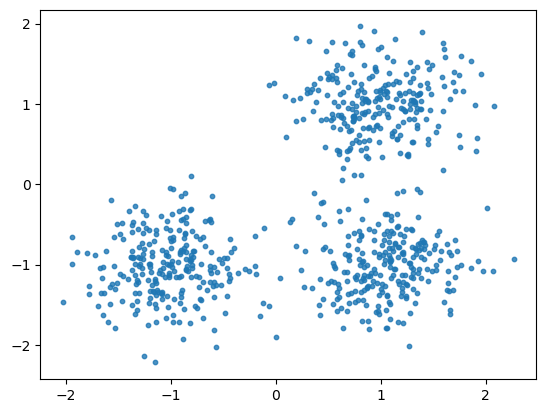

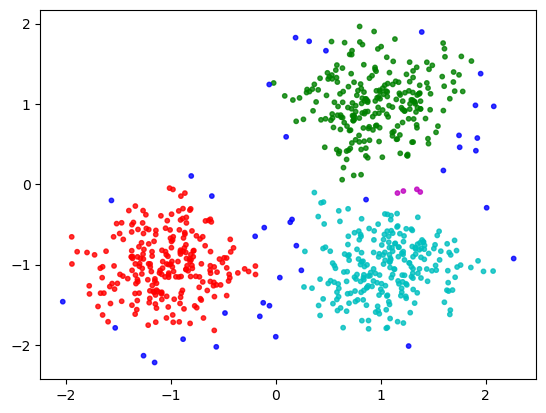

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

centers = [[1, 1], [-1, -1], [1, -1]]
X, _ = datasets.make_blobs(n_samples=750, centers=centers, cluster_std=0.4,
                            random_state=0)
plt.scatter(X[:,0],X[:,1],s=10, alpha=0.8)
plt.show()

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignments = [0 for _ in range(len(self.dataset))] # 0 means not assigned

    def distance(self, i, j):
        """
            should return euclidean distance
        """
        return np.linalg.norm(self.dataset[i] - self.dataset[j])

    def get_neighborhood(self, i):
        neighborhood = []
        for j in range(len(self.dataset)):
            if self.distance(i,j) <= self.epsilon and i != j:
                neighborhood.append(j)
        return neighborhood

    def is_core(self, i):
        return len(self.get_neighborhood(i)) >= self.min_pts

    def assign(self, i, cluster_num):
        self.assignments[i] = cluster_num
        neighbor_queue = self.get_neighborhood(i)

        while neighbor_queue:
            next_candidate = neighbor_queue.pop()
            if self.assignments[next_candidate] != 0:
                # already assignemd
                # duplicates can occur when adding points in neiborhoods
                # than have not been assigned
                continue

            self.assignments[next_candidate] = cluster_num

            if self.is_core(next_candidate):
                next_neighborhood = self.get_neighborhood(next_candidate)

                neighbor_queue += [i for i in next_neighborhood if self.assignments[i] == 0]

        return
    
    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        cluster_num = 1
        for i in range(len(self.dataset)):
            if self.is_core(i) and self.assignments[i] == 0:
                self.assign(i, cluster_num)

                cluster_num += 1

        return self.assignments

clustering = DBC(X, 3, 0.2).dbscan()
colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
colors = np.hstack([colors] * 40)
plt.scatter(X[:, 0], X[:, 1], color=colors[clustering].tolist(), s=10, alpha=0.8)
plt.show()

## Challenge Problem

Using the code above and the template provided below, create the animation below of the DBScan algorithm.

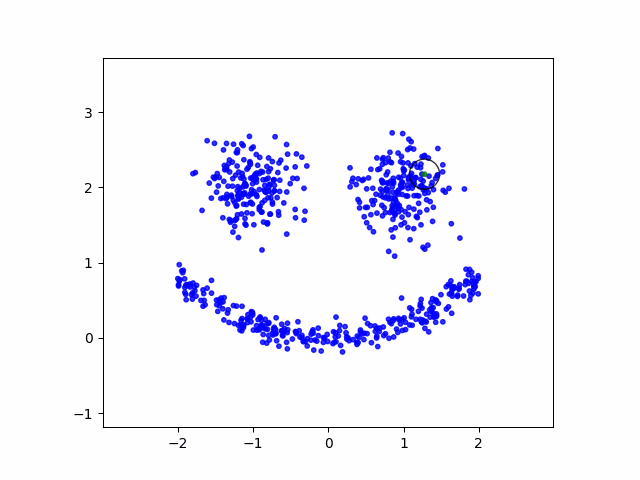

In [2]:
from IPython.display import Image
Image(filename="dbscan_2.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs

In [2]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import sklearn.datasets as datasets
import io

class DBC:

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts 
        self.epsilon = epsilon
        self.labels = np.zeros(len(self.dataset), dtype=int)
        self.snaps = []

    def snapshot(self,current):
        fig, ax = plt.subplots()
        colors=np.array(['b']).repeat(200)
        colors[self.labels==1]='r'
        colors[self.labels==2]='g'
        colors[self.labels==3]='c'
        colors[self.labels==4]='y'
        ax.scatter(self.dataset[:, 0], self.dataset[:, 1], color=colors, alpha=0.5, edgecolor='k')
        cir = plt.Circle((self.dataset[current,0], self.dataset[current, 1]), self.epsilon, color='k', fill=False)
        ax.add_patch(cir)

        ax.set_aspect('equal')
        plt.xlim(np.min(self.dataset[:, 0]) - 1, np.max(self.dataset[:, 0]) + 1)
        plt.ylim(np.min(self.dataset[:, 1]) - 1, np.max(self.dataset[:, 1]) + 1)
        
        buf = io.BytesIO()
        plt.savefig(buf, format='png')
        plt.close(fig) 
        buf.seek(0)
        
        image = Image.open(buf)
        image.load() 
        buf.close()
        
        self.snaps.append(image)

    def get_neighborhood(self, i):
        neigh = NearestNeighbors(radius=self.epsilon)
        neigh.fit(self.dataset)
        indices = neigh.radius_neighbors([self.dataset[i]], return_distance=False)[0]
        return indices

    def expand_cluster(self, i, neighbors, cluster_id):
        self.labels[i] = cluster_id
        k = 0
        while k < len(neighbors):
            j = neighbors[k]
            if self.labels[j] == -1:
                self.labels[j] = cluster_id  # Change label
            elif self.labels[j] == 0:
                self.labels[j] = cluster_id
                j_neighbors = self.get_neighborhood(j)
                if len(j_neighbors) >= self.min_pts:
                    neighbors = np.append(neighbors, j_neighbors)
            k += 1
            self.snapshot(j)  # Take a snapshot


    def dbscan(self):
        cluster_id = 1
        for i in range(len(self.dataset)):
            if self.labels[i] != 0:
                continue
            neighbors = self.get_neighborhood(i)
            if len(neighbors) < self.min_pts:
                self.labels[i] = -1  # Mark as noise
            else:
                self.expand_cluster(i, neighbors, cluster_id)
                cluster_id += 1
        return self.labels

# Create the dataset for the face
centers = [[1, 2], [-1, 2]]
eyes, _ = datasets.make_blobs(n_samples=100, centers=centers, cluster_std=0.25)

mouth_x = np.linspace(-2, 2, 100)
mouth_y = 0.2 * mouth_x ** 2 + 0.1 * np.random.randn(100)
mouth = np.vstack((mouth_x, mouth_y)).T

face = np.concatenate([eyes, mouth], axis=0)

# Instantiate DBC and run DBSCAN
dbc = DBC(face, 3, 0.2)
dbc.dbscan()


array([ 1,  1,  1,  1,  1,  2,  1,  1,  2,  2,  2,  1,  2,  2,  2,  2,  2,
        1,  1,  2,  1,  2,  1,  1,  1,  1,  1,  2,  2,  2,  1,  2,  2,  1,
       -1,  1,  1,  2,  1,  2,  1, -1,  2,  1,  2,  1,  2,  2,  2,  2,  2,
        1,  1,  1,  2,  2,  1,  1,  2,  2,  1,  1,  1,  1,  2,  1,  1,  1,
        1,  1,  2, -1, -1, -1,  2,  2,  1,  2,  2,  2,  1,  2,  2,  2, -1,
       -1,  1,  1,  2, -1,  1,  1,  2,  1,  2,  2,  2,  1,  2, -1,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3])

In [3]:
# Save the snapshots as a GIF
if dbc.snaps:  # Ensure there are snapshots to save
    dbc.snaps[0].save(
        'dbscan_0.gif',  # Save to writable directory
        save_all=True,
        append_images=dbc.snaps[1:],
        optimize=False,
        loop=0,
        duration=10
    )


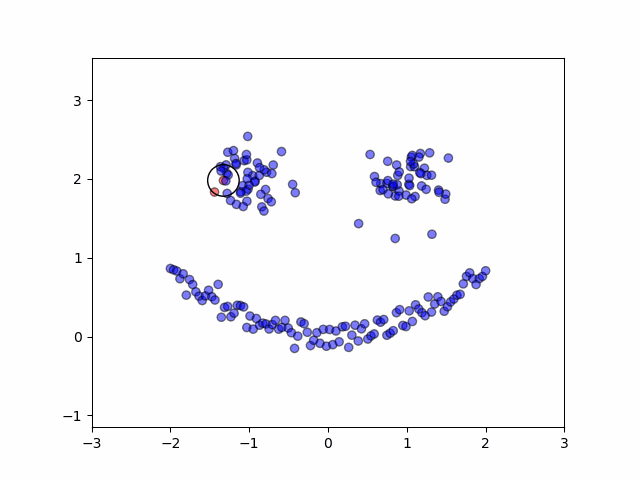

In [4]:
from IPython.display import Image
Image(filename="dbscan_0.gif", width=500, height=500)